<a href="https://colab.research.google.com/github/skrofman/Applied-Machine-Learning/blob/master/DATA_310_Lecture_37_Spring_2021.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DATA 310 Lecture 37 - Spring 2021 

<font face="Calibri" color="darkgreen" size=8> Grid Search Algorithms</font> 

##<font color='navy'> Motivation
<font color='crimson'>Why we need "grid search" algorithms?</font> We deal with a problem of non-convex optimization and just finding a local minima is not good enough; also cannot easily compute the direction (gradient) for improving the hyperparameters that we try to optimize.

**Main Idea**: We can use algorthms for discrete optimization in order to estimate the value for the *hyperparameters* and thus complete the *model selection* process. 

A *Grid Search* will involve subdividing the range of the parameters by using small increments and then the grid search algorithm is choosing the value of the parameters from a finite set of choices within the range.

The simplest *grid search algorithm* is an exhaustive search, namely loop through all the candidates and pick the one that is the *best* according to predefined criteria, such as minimizing the k-fold cross-validated loss or maximizing the accuracy, etc.

<span style="font-family:Calibri; color:DodgerBlue; font-size:14pt;">Important:</span> In practice we cannot search all the points in a multi-dimensional grid, it is computationally too expensive. We need a strategy that efficiently approximates the solution.

**Example**: Assume that we want to determine the best tree depth *and* the best leaf size for a classification tree. The following image color-codes the values of the cost function based on the grid values.

<figure>
<center>
<img src='https://drive.google.com/uc?id=1EVr1hhK44KMTgke8U8feyfSm2mtA27uy' 
width='500px' />
<figcaption>Example of a Function by Arrow Diagram</figcaption></center>
</figure>


<span style="font-family:Calibri; color:DeepPink; font-size:14pt;">Critical Thinking Question:</span> If we compute the cost function at some random point on the grid how do we know in what direction we can continue to search for improving (lowering) the value of the cost function?

<figure>
<center>
<img src='https://drive.google.com/uc?id=1jtywm9tz-eZWevgGo1RWQ9PM15EOnb3K' 
width='500px' />
<figcaption>Example of a Function by Arrow Diagram</figcaption></center>
</figure>


##<font color='navy'> Swarm Algorithms - Particle Swarm Optimization

Main Idea: consider a collection of particles that move around the search space influenced by their own best past location and the best past location of the whole swarm or a close neighbor.

<figure>
<center>
<img src='https://drive.google.com/uc?id=1dZibCB20kaKcqpQQ2v2JCLERzXTlWNuO' 
width='500px' />
<figcaption>Example of a Function by Arrow Diagram</figcaption></center>
</figure>


$$v_i (t+1)=v_i (t)+c_1⋅\chi⋅(p_i^{\text{best}} (t)−p_i (t))+c_2⋅\chi⋅(p^{\text{gbest}} (t)−p_i (t))$$

where $$\chi \sim \text{Unif}(0,1)$$ and $c_1$ and $c_2$ are constants.

The particle positions: $$p_{i} (t+1)=p_i  (t)+v_i (t)$$

**Heuristics**

  - The number of particles should be low, around 20-40
    
  - The speed a particle can move (maximum change in its position per iteration) should be bounded, such as to a percentage of the size of the domain.
    
  - The learning factors (biases towards global and personal best positions) should be between 0 and 4, typically 2.
    
  - A local bias (local neighborhood) factor can be introduced where neighbors are determined based on Euclidean distance between particle positions.
    
  - Particles may leave the boundary of the problem space and may be penalized, be reflected back into the domain or biased to return back toward a position in the problem domain. Alternatively, a wrapping strategy may be used at the edge of the domain creating a loop, torrid or related geometrical structures at the chosen dimensionality.

An inertia or momentum coefficient can be introduced to limit the change in velocity.

##<font color='navy'> Simulated Annealing

**Main Idea**: drop a random trial point and then, based on the value of the objective function, continue to drop other points at a certain distance. The distance between consecutive points is measured as a function of the "temperature" which is decreasing based on an exponential law.

**Important** This method use only one point at a time. The temperature of the grid is deacreasing, such as $T_{i+1}=rT_{i}$ where $0<r<1.$ The probability that the system will transition from state $e_i$ to state $e_{i+1}$ is 

$$\mathbb{P}(e_{i+1}\text{at temperature } T_i)=e^{-(\text{New Loss} - \text{Loss})/T_i}$$

Decision to continue: if  $\mathbb{P}(e_{i+1}\text{at temperature } T_i)>\chi$ where $\chi \sim \text{Unif}(0,1).$

Formal steps:

- Let $s=s_0$ where $s_0$ is a random guess.
- For $k = 0$ through $k_{max}$ (excluding $k_{max}$, $k$ is decreasing):
- Set $T←\text{temperature}((k+1)/k_{max})$
- Pick a random neighbor, $s_{new}←\text{neighbor}(s)$
- If $\mathbb{P}(s_{new},T)>\text{random}(0,1)$ then $s→s_{new}$
Output: the final state $s$


There are many other grid search algorithms in discrete optimization such as “cuckoo search” or the “genetic algorithm”.

Intuitive example for the genetic algorithm: https://www.youtube.com/watch?v=FKbarpAlBkw

##<font color='navy'> Example in Python of Particle Swarm Optimization

### A 2D Animation

In [ ]:
pip install pyswarms

In [ ]:
# Import modules
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Image

# Import PySwarms
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
from pyswarms.utils.plotters import (plot_cost_history, plot_contour, plot_surface)

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [ ]:
options = {'c1':0.3, 'c2':0.01, 'w':0.9}
optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=2, options=options)
cost, pos = optimizer.optimize(fx.sphere, iters=100)

2020-10-29 12:55:28,855 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.3, 'c2': 0.01, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=1.66e-6
2020-10-29 12:55:29,024 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 1.6579691609323948e-06, best pos: [-0.00126791  0.00022444]


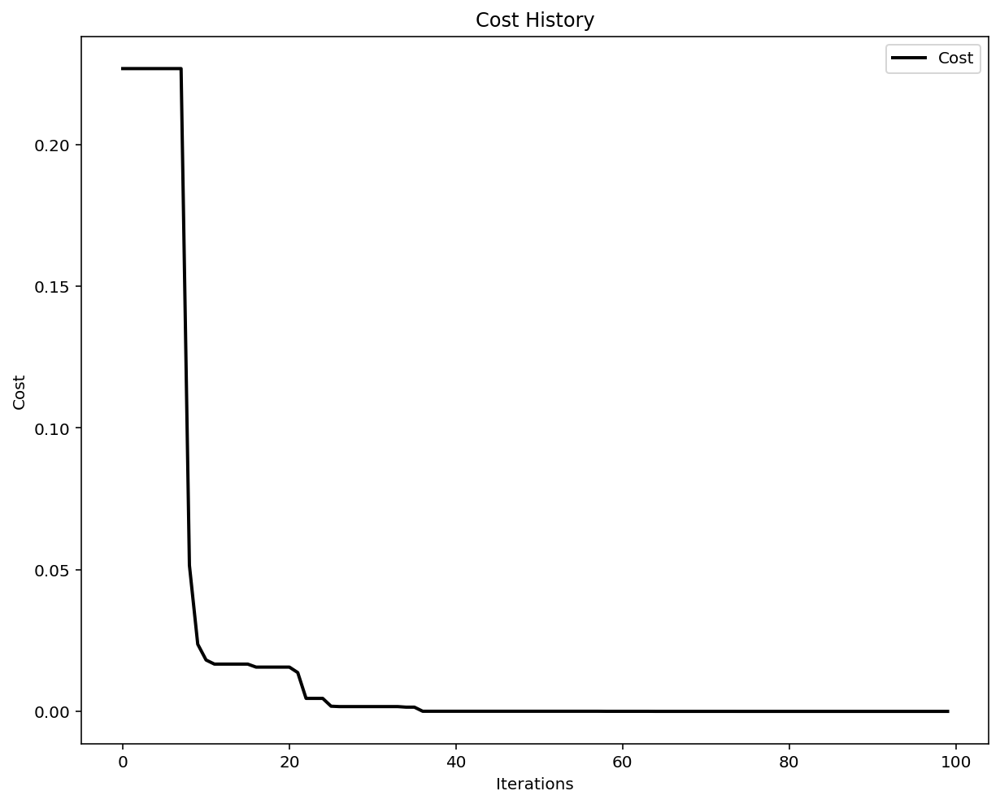

In [ ]:
plot_cost_history(cost_history=optimizer.cost_history)
plt.show()

In [ ]:
from pyswarms.utils.plotters.formatters import Mesher

In [ ]:
# Initialize mesher with sphere function
m = Mesher(func=fx.sphere)

In [ ]:
%%capture
# Make animation
animation = plot_contour(pos_history=optimizer.pos_history,mesher=m,mark=(0,0))

2020-10-29 12:55:51,057 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


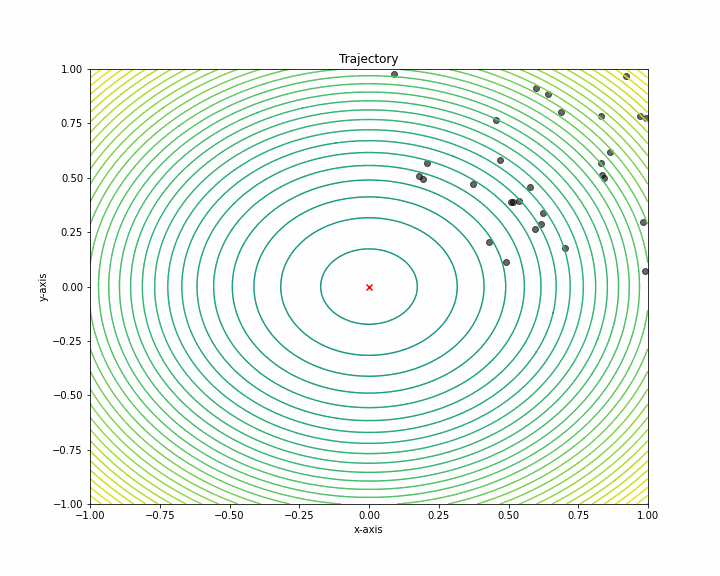

In [ ]:
# Enables us to view it in a Jupyter notebook
animation.save('result2D.gif', writer='pillow', fps=10)
Image(open('result2D.gif','rb').read())

### A 3D Animation

In [ ]:
# Obtain a position-fitness matrix using the Mesher.compute_history_3d()
# method. It requires a cost history obtainable from the optimizer class
pos_history_3d = m.compute_history_3d(optimizer.pos_history)

In [ ]:
# Make a designer and set the x,y,z limits to (-1,1), (-1,1) and (-0.1,1) respectively
from pyswarms.utils.plotters.formatters import Designer
d = Designer(limits=[(-1,1), (-1,1), (-0.1,1)], label=['x-axis', 'y-axis', 'z-axis'])

In [ ]:
%%capture
# Make animation
animation3d = plot_surface(pos_history=pos_history_3d, # Use the cost_history we computed
                           mesher=m, designer=d,       # Customizations
                           mark=(0,0,0))  

2020-10-29 12:58:13,511 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


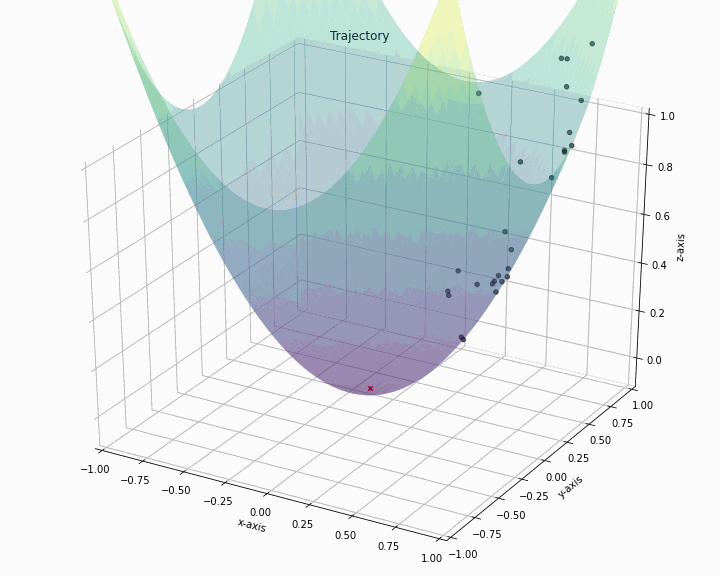

In [ ]:
animation3d.save('result3D.gif', writer='pillow', fps=10)
Image(open('result3D.gif','rb').read())

##<font color='navy'> Example in Python with GridsearchCV and Simmulated Annealing

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.datasets import load_boston
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
plt.rc('font', size=16)
plt.rc('axes', titlesize=16)

In [ ]:
data = load_boston()
X = data.data
feats = data.feature_names
y = data.target

In [ ]:
%%time
lasreg = Lasso()
params = [{'alpha':np.linspace(0.001,1,num=200)}]
gs = GridSearchCV(estimator=lasreg,cv=10,scoring='neg_mean_squared_error',param_grid=params)
gs_results = gs.fit(X,y)
print(gs_results.best_params_)
print('The mean square error is: ', np.abs(gs_results.best_score_))

{'alpha': 0.5532110552763819}
The mean square error is:  32.96963885442217
CPU times: user 2.92 s, sys: 2.83 ms, total: 2.92 s
Wall time: 2.93 s


In [ ]:
%%time
model = ElasticNet()
params = [{'alpha':np.linspace(0.001,1,num=50),'l1_ratio':np.linspace(0,1,num=50)}]
gs = GridSearchCV(estimator=model,cv=10,scoring='neg_mean_squared_error',param_grid=params)
gs_results = gs.fit(X,y)
print(gs_results.best_params_)
print('The mean square error is: ', np.abs(gs_results.best_score_))

In [ ]:
gs_results

In [ ]:
MIN_ALPHA = 1e-10
MAX_ALPHA = 2
STEP_SIZE = 1     # Std of gaussian steps
COOLING = 0.95     # T_{n+1} = T_{n}*COOLING, i.e. geometric cooling

In [ ]:
def cost_function(model):
    k_fold = cross_val_score(estimator=model,X=X,y=y,cv=10,scoring='neg_mean_squared_error')
    return -k_fold.mean()
def random_start():
    alpha = np.random.random()*(MAX_ALPHA-MIN_ALPHA) + MIN_ALPHA
    return alpha
def random_neighbour(alpha,T):
    delta_alpha = np.random.normal()*STEP_SIZE*T
    new_alpha = min(MAX_ALPHA, max(MIN_ALPHA, alpha+delta_alpha))
    return new_alpha
def acceptance_probability(cost, new_cost, temperature):
    if new_cost < cost:
        return 1
    else:
        p = np.exp(-(new_cost - cost) / temperature)
        return p
def locate_min(a):
    smallest = min(a)
    return smallest, [index for index, element in enumerate(a) if smallest == element]

def annealing(alpha0 = random_start()):
    # Start with a random configuration
    # alpha = random_start()
    alpha = alpha0
    # All layers will have the same number of nodes (keep the example from getting too complicated)
    model = Lasso(random_state=1, alpha=alpha)
    
    # Compute the cost function (in this case, 1-accuracy)
    cost = cost_function(model)
    
    # Keep lists of results, start with the current
    states, costs = [alpha], [cost]
    T = 1
    while T > 1e-10:
        new_alpha = random_neighbour(alpha,T)
        model = Lasso(random_state=1234, alpha=new_alpha)
        new_cost = cost_function(model)
        if acceptance_probability(cost, new_cost, T) > np.random.random():
            cost = new_cost
            alpha = new_alpha
            states.append(alpha)
            costs.append(cost)
        T = T*COOLING
    return model,states,costs

Lowest cost function value: 32.96965739096608
Best alpha value(s):
[0.5548918309199344]


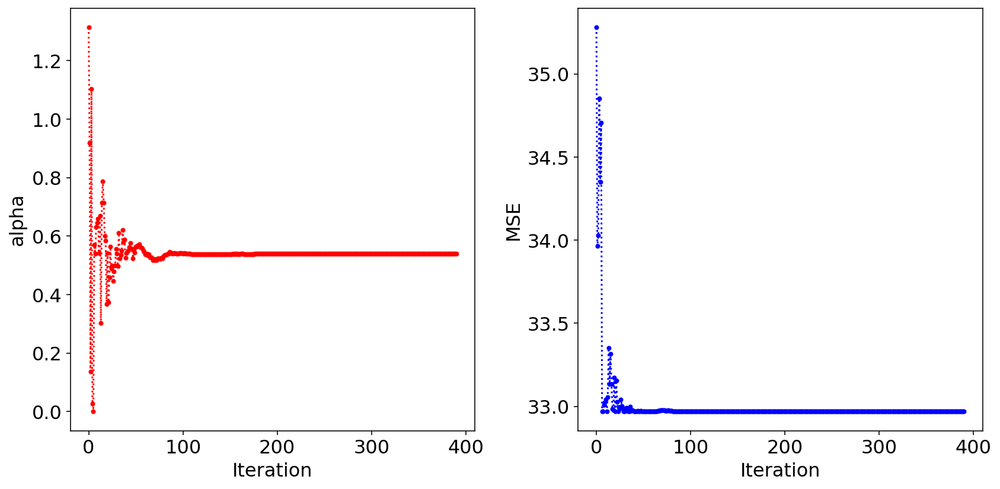

CPU times: user 8.01 s, sys: 134 ms, total: 8.15 s
Wall time: 8.04 s


In [ ]:
%%time
model,states,costs = annealing()

lowest_cost, best_states = locate_min(costs)
print('Lowest cost function value: ' + str(lowest_cost))
print('Best alpha value(s):')
print([states[idx] for idx in best_states])

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.plot(states,':.r')
plt.xlabel('Iteration')
plt.ylabel('alpha')
plt.subplot(1,2,2)
plt.plot(costs,':.b')
plt.xlabel('Iteration')
plt.ylabel('MSE')
plt.tight_layout()
plt.show()

Text(0, 0.5, 'MSE')

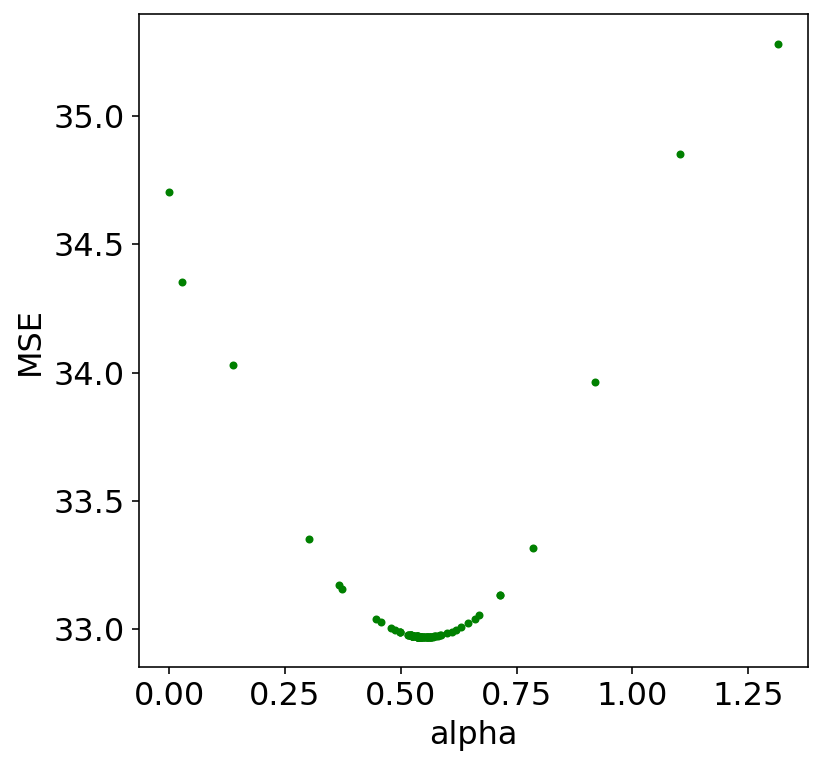

In [ ]:
plt.figure(figsize=(6,6))
plt.plot(states,costs,'.g')
plt.xlabel('alpha')
plt.ylabel('MSE')